In [1]:
#%% Setting Up
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import xarray as xr
# import xesmf as xe
import networkx as nx
# import rioxarray as rxr

import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from shapely.geometry import Point
from shapely.geometry import Polygon

import glob
import os
import itertools
import tqdm
import gc
import time
import pickle

from joblib import Parallel, delayed

import torch

import configparser
cfg = configparser.ConfigParser()
cfg.optionxform = str
cfg.read('/home/sarth/rootdir/datadir/assets/defaults.ini')
cfg = {s: dict(cfg.items(s)) for s in cfg.sections()}
PATHS = cfg['PATHS']

print("Setting up...")

Setting up...


In [2]:
filepath = lambda x, region, mode: os.path.join('/home/sarth/rootdir/workdir/projects/Paper_Data_Latency/Revised_Figure05', f'v{x}_{mode}_{region}_test_metrics.nc')

# Historical: (x, region, mode): (2, 'camelsus'/'camelsind'/'hysets', 'surr')
# Filtered ERA5 variables: (x, region, mode): (1, 'camelsus'/'camelsind'/'hysets', 'lat')
# GPM-Final only: (x, region, mode): (2, 'camelsus'/'camelsind'/'hysets', 'lat')
# No Meteorological: (x, region, mode): (3, 'camelsus'/'camelsind'/'hysets', 'lat')
# HRES: (x, region, mode): (4, 'camelsus'/'camelsind'/'hysets', 'lat')

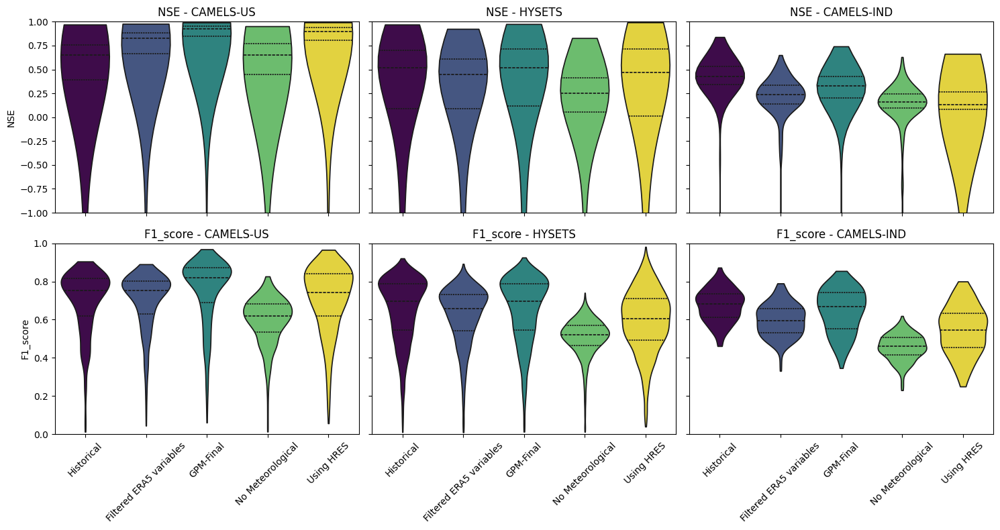

In [6]:
# For each experiment, we define (version, mode)
experiments = {
    "Historical": (2, "surr"),
    "Filtered ERA5 variables": (1, "lat"),
    "GPM-Final": (2, "lat"),
    "No Meteorological": (3, "lat"),
    "Using HRES": (4, "lat")
}

# Map column titles to region keys used by filepath
regions = {
    "CAMELS-US": "camelsus",
    "HYSETS": "hysets",
    "CAMELS-IND": "camelsind"
}

# Metrics and their corresponding y-axis limits
metrics = ['NSE', 'F1_score']
ylims = {'NSE': (-1, 1), 'F1_score': (0, 1)}

# Define a colormap, here we use 'viridis' so colors can be modified easily.
cmap = plt.get_cmap('viridis')
# Generate a list of colors for the 5 experiments.
colors = cmap(np.linspace(0, 1, len(experiments)))

# Create a figure with 2 rows (metrics) and 3 columns (regions)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 8), sharey='row', sharex=True)

final_dataframe = {}
# Loop over metrics (rows) and regions (columns)
for row, metric in enumerate(metrics):
    for col, (region_title, region_key) in enumerate(regions.items()):
        ax = axes[row, col]
        # Collect data from all experiments: each will be a distribution over catmt_idx at lead_time index 0.
        data_list = []  # This will store the array of metric values.
        exp_labels = []  # Corresponding experiment names, repeated for each value.
        for exp_name, (v, mode) in experiments.items():
            nc_file = filepath(v, region_key, mode)
            ds = xr.open_dataset(nc_file)
            # Select the first lead time for the current metric and flatten any extra dimension on catmt_idx
            values = ds[metric].isel(lead_time=0).values.flatten()
            if metric == 'NSE':
                # Clip to -10
                values = np.clip(values, -10, 1)
            data_list.append(values)
            exp_labels.append(exp_name)
        
        # Combine the data into a long-form DataFrame for seaborn
        combined = pd.DataFrame({
            "Experiment": np.concatenate([np.repeat(exp, len(arr)) for exp, arr in zip(exp_labels, data_list)]),
            "Value": np.concatenate(data_list)
        })
        final_dataframe[f"{metric}_{region_key}"] = combined  # Store for potential later use
        
        # Use seaborn's violinplot with the defined color palette.
        sns.violinplot(x="Experiment", y="Value", data=combined, palette=colors, ax=ax, inner='quartile', cut=0)
        ax.set_title(f"{metric} - {region_title}")
        ax.set_ylim(ylims[metric])
        ax.set_xlabel("")  # Remove xlabel if not needed.
        if col == 0:
            ax.set_ylabel(metric)
        else:
            ax.set_ylabel("")
        ax.tick_params(axis='x', rotation=45)  # Rotate x-tick labels for clarity

plt.tight_layout()
plt.show()

In [ ]:
# # For each experiment, we define (version, mode)
# experiments = {
#     "Historical": (2, "surr"),
#     "Filtered ERA5 variables": (1, "lat"),
#     "GPM-Final": (2, "lat"),
#     "No Meteorological": (3, "lat"),
#     "Using HRES": (4, "lat")
# }

# # Map column titles to region keys used by filepath
# regions = {
#     "CAMELS-US": "camelsus",
#     "HYSETS": "hysets",
#     "CAMELS-IND": "camelsind"
# }

# # Metrics and their corresponding y-axis limits
# metrics = ['NSE', 'F1_score']
# ylims = {'NSE': (-1, 1), 'F1_score': (0, 1)}

# # Define a colormap, here we use 'viridis' so colors can be modified easily.
# cmap = plt.get_cmap('viridis')
# # Generate a list of colors for the 5 experiments.
# colors = cmap(np.linspace(0, 1, len(experiments)))

# # Create a figure with 2 rows (metrics) and 3 columns (regions)
# fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 8), sharey=False)

# final_dataframe = {}
# # Loop over metrics (rows) and regions (columns)
# for row, metric in enumerate(metrics):
#     for col, (region_title, region_key) in enumerate(regions.items()):
#         ax = axes[row, col]
#         # Collect data from all experiments: each will be a distribution over catmt_idx at lead_time index 0.
#         data_list = []  # This will store the array of metric values.
#         exp_labels = []  # Corresponding experiment names, repeated for each value.
#         for exp_name, (v, mode) in experiments.items():
#             nc_file = filepath(v, region_key, mode)
#             ds = xr.open_dataset(nc_file)
#             # Select the first lead time for the current metric and flatten any extra dimension on catmt_idx
#             values = ds[metric].isel(lead_time=0).values.flatten()
#             if metric == 'NSE':
#                 # Clip to -10
#                 values = np.clip(values, -10, 1)
#             data_list.append(values)
#             exp_labels.append(exp_name)
        
#         # Combine the data into a long-form DataFrame for seaborn
#         combined = pd.DataFrame({
#             "Experiment": np.concatenate([np.repeat(exp, len(arr)) for exp, arr in zip(exp_labels, data_list)]),
#             "Value": np.concatenate(data_list)
#         })
#         final_dataframe[f"{metric}_{region_key}"] = combined  # Store for potential later use
        
#         # Use seaborn's violinplot with the defined color palette.
#         sns.violinplot(x="Experiment", y="Value", data=combined, palette=colors, ax=ax, inner='quartile', cut=0)
#         sns.swarmplot(x="Experiment", y="Value", data=combined, color='k', size=3, ax=ax, alpha=0.6)
#         ax.set_title(f"{metric} - {region_title}")
#         ax.set_ylim(ylims[metric])
#         ax.set_xlabel("")  # Remove xlabel if not needed.
#         if col == 0:
#             ax.set_ylabel(metric)
#         else:
#             ax.set_ylabel("")
#         ax.tick_params(axis='x', rotation=45)  # Rotate x-tick labels for clarity

# plt.tight_layout()
# plt.show()

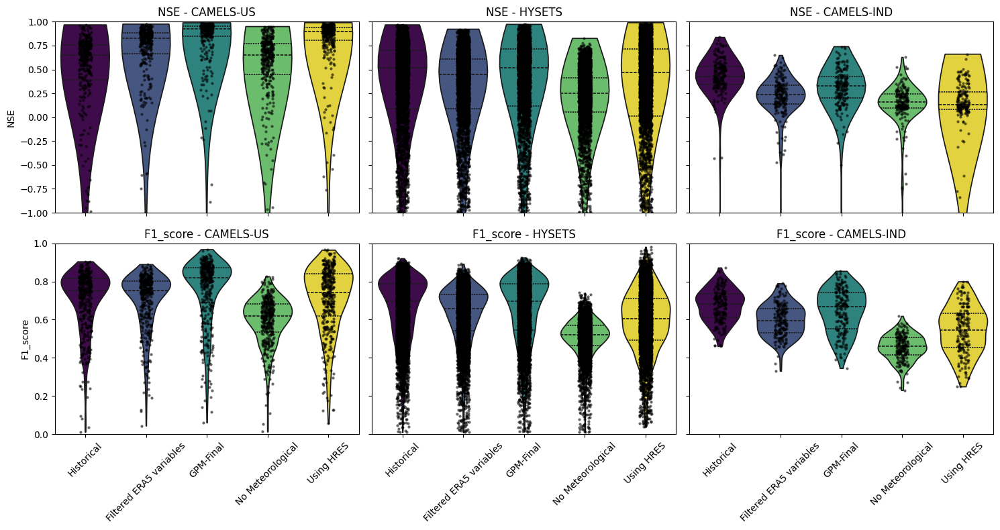

In [5]:
# For each experiment, we define (version, mode)
experiments = {
    "Historical": (2, "surr"),
    "Filtered ERA5 variables": (1, "lat"),
    "GPM-Final": (2, "lat"),
    "No Meteorological": (3, "lat"),
    "Using HRES": (4, "lat")
}

# Map column titles to region keys used by filepath
regions = {
    "CAMELS-US": "camelsus",
    "HYSETS": "hysets",
    "CAMELS-IND": "camelsind"
}

# Metrics and their corresponding y-axis limits
metrics = ['NSE', 'F1_score']
ylims = {'NSE': (-1, 1), 'F1_score': (0, 1)}

# Define a colormap, here we use 'viridis' so colors can be modified easily.
cmap = plt.get_cmap('viridis')
# Generate a list of colors for the 5 experiments.
colors = cmap(np.linspace(0, 1, len(experiments)))

# Create a figure with 2 rows (metrics) and 3 columns (regions)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 8), sharey='row', sharex=True)

final_dataframe = {}
# Loop over metrics (rows) and regions (columns)
for row, metric in enumerate(metrics):
    for col, (region_title, region_key) in enumerate(regions.items()):
        ax = axes[row, col]
        # Collect data from all experiments: each will be a distribution over catmt_idx at lead_time index 0.
        data_list = []  # This will store the array of metric values.
        exp_labels = []  # Corresponding experiment names, repeated for each value.
        for exp_name, (v, mode) in experiments.items():
            nc_file = filepath(v, region_key, mode)
            ds = xr.open_dataset(nc_file)
            # Select the first lead time for the current metric and flatten any extra dimension on catmt_idx
            values = ds[metric].isel(lead_time=0).values.flatten()
            if metric == 'NSE':
                # Clip to -10
                values = np.clip(values, -10, 1)
            data_list.append(values)
            exp_labels.append(exp_name)
        
        # Combine the data into a long-form DataFrame for seaborn
        combined = pd.DataFrame({
            "Experiment": np.concatenate([np.repeat(exp, len(arr)) for exp, arr in zip(exp_labels, data_list)]),
            "Value": np.concatenate(data_list)
        })
        final_dataframe[f"{metric}_{region_key}"] = combined  # Store for potential later use
        
        # Use seaborn's violinplot with the defined color palette.
        sns.violinplot(x="Experiment", y="Value", data=combined, palette=colors, ax=ax, inner='quartile', cut=0)
        sns.stripplot(x="Experiment", y="Value", data=combined, color='k', size=3, ax=ax, alpha=0.6, jitter=True)
        ax.set_title(f"{metric} - {region_title}")
        ax.set_ylim(ylims[metric])
        ax.set_xlabel("")  # Remove xlabel if not needed.
        if col == 0:
            ax.set_ylabel(metric)
        else:
            ax.set_ylabel("")
        ax.tick_params(axis='x', rotation=45)  # Rotate x-tick labels for clarity

plt.tight_layout()
plt.show()

In [30]:
# For each experiment, we define (version, mode)
experiments = {
    "Historical": (2, "surr"),
    "GPM-Final": (1, "lat"),
    "Filtered ERA5 \nvariables": (2, "lat"),
    "No Meteorological": (3, "lat"),
    "Using HRES": (4, "lat")
}

# Map column titles to region keys used by filepath
regions = {
    "CAMELS-US": "camelsus",
    "HYSETS": "hysets",
    "CAMELS-IND": "camelsind"
}

# Metrics and their corresponding y-axis limits
metrics = ['NSE', 'F1_score']
ylims = {'NSE': (-1, 1), 'F1_score': (0, 1)}

# Define a colormap, here we use 'viridis' so colors can be modified easily.
cmap = plt.get_cmap('viridis')
# Generate a list of colors for the 5 experiments.
colors = cmap(np.linspace(0, 1, len(experiments)))

# Create a figure with 2 rows (metrics) and 3 columns (regions)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(30, 16), sharey='row', sharex=True, dpi = 600)

final_dataframe = {}
# Loop over metrics (rows) and regions (columns)
for row, metric in enumerate(metrics):
    for col, (region_title, region_key) in enumerate(regions.items()):
        ax = axes[row, col]
        # Collect data from all experiments: each will be a distribution over catmt_idx at lead_time index 0.
        data_list = []  # This will store the array of metric values.
        exp_labels = []  # Corresponding experiment names, repeated for each value.
        for exp_name, (v, mode) in experiments.items():
            nc_file = filepath(v, region_key, mode)
            ds = xr.open_dataset(nc_file)
            # Select the first lead time for the current metric and flatten any extra dimension on catmt_idx
            values = ds[metric].isel(lead_time=0).values.flatten()
            if metric == 'NSE':
                # Clip to -10
                values = np.clip(values, -10, 1)
            data_list.append(values)
            exp_labels.append(exp_name)
        
        # Combine the data into a long-form DataFrame for seaborn
        combined = pd.DataFrame({
            "Experiment": np.concatenate([np.repeat(exp, len(arr)) for exp, arr in zip(exp_labels, data_list)]),
            "Value": np.concatenate(data_list)
        })
        final_dataframe[f"{metric}_{region_key}"] = combined  # Store for potential later use

        # Make a hybrid vertical plot:
        # Half Violin: plot the full violin then clip the left half.
        ax = sns.violinplot(x="Experiment", y="Value", data=combined, palette=colors, ax=ax, inner='quartile', cut=0)
        # For a vertical violin, the left half is clipped.
        for item in ax.collections:
            x0, y0, width, height = item.get_paths()[0].get_extents().bounds
            if metric == 'NSE':
                y0 = -1
                height = 2
            item.set_clip_path(plt.Rectangle((x0, y0), width/2, height, transform=ax.transData))
            # if metric == 'NSE':
            #     print(f"Clipped violin at x={x0}, y={y0}, width={width}, height={height}")
        
        # Create strip plots with high transparency
        num_items = len(ax.collections)
        sns.stripplot(x="Experiment", y="Value", data=combined, color='k', size=3, ax=ax, alpha=0.33, jitter=True)
        # Shift each strip plot to the left of the corresponding violin.
        for item in ax.collections[num_items:]:
            item.set_offsets(item.get_offsets() + np.array([0.15, 0]))
        
        # Create narrow boxplots on top of the violin and strip plots, with thick lines and plot mean values without outliers.
        # sns.boxplot(x='Experiment', y='Value', data=combined, width=0.25,
        #             showfliers=False, showmeans=False, 
        #             # meanprops=dict(marker='o', markerfacecolor='darkorange',
        #             #                markersize=10, zorder=3),
        #             boxprops=dict(facecolor=(0,0,0,0), 
        #                           linewidth=3, zorder=3),
        #             whiskerprops=dict(linewidth=3),
        #             capprops=dict(linewidth=3),
        #             medianprops=dict(linewidth=3), ax=ax)
        
        # ax.set_title(f"{metric} - {region_title}")

        if metric == 'NSE':
            ax.set_title(f"{region_title}")

        ax.set_ylim(ylims[metric])

        ax.set_xlabel("")  # Remove xlabel if not needed.
        if col == 0:
            ax.set_ylabel(metric)
        else:
            ax.set_ylabel("")
        ax.tick_params(axis='x', rotation=30)  # Rotate x-tick labels for clarity

# Increase all tick, label and title font sizes for better readability
for ax in axes.flatten():
    ax.title.set_fontsize(32)
    ax.xaxis.label.set_fontsize(28)
    ax.yaxis.label.set_fontsize(28)
    ax.tick_params(axis='both', which='major', labelsize=24)

    # Horizontal grid lines for better readability (high alpha)
    ax.yaxis.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


In [17]:
height

np.float64(0.55)

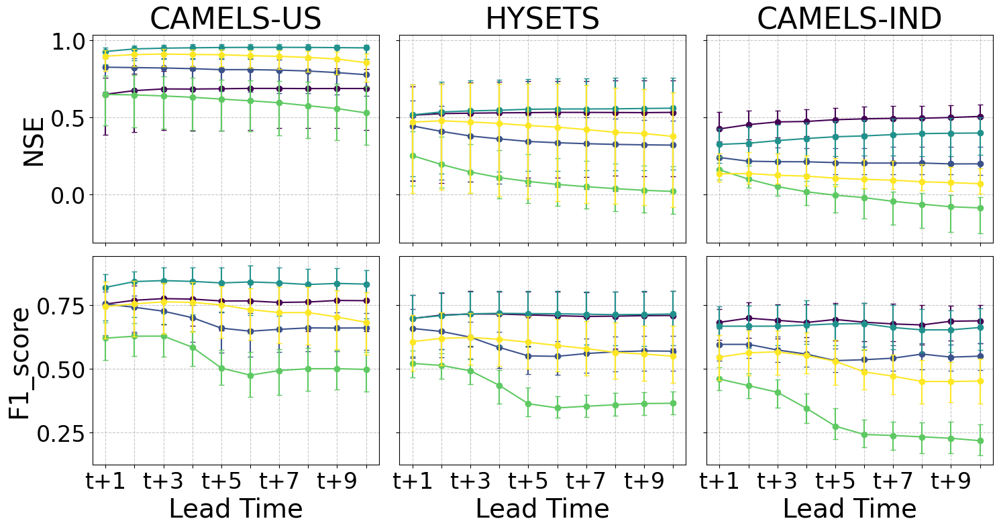

In [43]:
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(15, 8), sharey='row', sharex=True)

for row, metric in enumerate(metrics):
    for col, (region_title, region_key) in enumerate(regions.items()):
        ax = axes[row, col]
        # Loop over experiments to plot each line with nanmedian and error bars for 25th-75th percentiles
        for i, (exp_name, (v, mode)) in enumerate(experiments.items()):
            nc_file = filepath(v, region_key, mode)
            ds = xr.open_dataset(nc_file)
            # Extract lead_time coordinate and metric data (assumed shape: (lead_time, catmt_idx))
            x = ds['lead_time'].values
            data = ds[metric].values
            # For NSE, clip values to the range -10 to 1
            if metric == 'NSE':
                data = np.clip(data, -10, 1)
            med = np.nanmedian(data, axis=1)
            lower = np.nanpercentile(data, 25, axis=1)
            upper = np.nanpercentile(data, 75, axis=1)
            # Calculate error values for errorbar call
            err_lower = med - lower
            err_upper = upper - med
            color = colors[i]
            # Plot the median line, fill area and error bars
            ax.plot(x, med, marker='o', color=color, label=exp_name)
            # ax.fill_between(x, lower, upper, color=color, alpha=0.3)
            ax.errorbar(x, med, yerr=[err_lower, err_upper], fmt='none', color=color, capsize=3)
                
        # Set title to region name and y-limits according to metric
        if metric == 'NSE':
            ax.set_title(region_title, fontsize=32)

        ax.set_xticks(range(10))
        # ax.set_xticklabels(range(1,11))
        ax.set_xticklabels([f"t+{i+1}" if i+1 in [1,3,5,7,9] else "" for i in range(10)])

        # ax.set_ylim(ylims[metric])
        # Labeling: left column gets y-label and bottom row gets x-label
        if col == 0:
            ax.set_ylabel(metric, fontsize=28)
        if row == 1:
            ax.set_xlabel("Lead Time", fontsize=28)
        ax.tick_params(axis='both', which='major', labelsize=24)
        ax.grid(True, linestyle='--', alpha=0.7)



plt.tight_layout()
plt.show()


In [50]:
from matplotlib.lines import Line2D

fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(30, 16), sharey='row', sharex=True, dpi =600)

offset_factor = 0.15  # adjust this value to increase/decrease offsets

for row, metric in enumerate(metrics):
    for col, (region_title, region_key) in enumerate(regions.items()):
        ax = axes[row, col]
        # Loop over experiments to plot each line with nanmedian and error bars for 25th-75th percentiles
        for i, (exp_name, (v, mode)) in enumerate(experiments.items()):
            nc_file = filepath(v, region_key, mode)
            ds = xr.open_dataset(nc_file)
            # Extract lead_time coordinate and metric data (assumed shape: (lead_time, catmt_idx))
            x = ds['lead_time'].values
            data = ds[metric].values
            # For NSE, clip values to the range -10 to 1
            if metric == 'NSE':
                data = np.clip(data, -10, 1)
            med = np.nanmedian(data, axis=1)
            lower = np.nanpercentile(data, 25, axis=1)
            upper = np.nanpercentile(data, 75, axis=1)
            # Calculate error values for errorbar call
            err_lower = med - lower
            err_upper = upper - med
            color = colors[i]
            
            # Compute an offset for the current experiment
            offset = (i - (len(experiments)-1)/2) * offset_factor
            # Plot the median line, adjusted by the offset, along with error bars
            ax.plot(x + offset, med, marker='o', color=color, label=exp_name)
            ax.errorbar(x + offset, med, yerr=[err_lower, err_upper], fmt='none', color=color, capsize=3)
                
        # Set title to region name and adjust x-tick labels
        if metric == 'NSE':
            ax.set_title(region_title, fontsize=32)

        ax.set_xticks(range(10))
        ax.set_xticklabels([f"t+{i+1}" if i+1 in [1,3,5,7,9] else "" for i in range(10)])
        
        # Labeling: left column gets y-label and bottom row gets x-label
        if col == 0:
            ax.set_ylabel(metric, fontsize=28)
        if row == 1:
            ax.set_xlabel("Lead Time", fontsize=28)
        ax.tick_params(axis='both', which='major', labelsize=24)
        ax.grid(True, linestyle='--', alpha=0.7)


        custom_handles = [
            Line2D([0], [0], marker='o', color=colors[i], markersize=8, lw=2, label=exp_name)
            for i, exp_name in enumerate(experiments)
        ]

        fig.legend(
            handles=custom_handles,
            loc='lower center',
            bbox_to_anchor=(0.5, -0.075),
            ncol=len(experiments),
            frameon=False,
            fontsize=28,
        )

plt.tight_layout()
plt.show()
